In [ ]:

# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES
# TO THE CORRECT LOCATION (/kaggle/input) IN YOUR NOTEBOOK,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.

import os
import sys
from tempfile import NamedTemporaryFile
from urllib.request import urlopen
from urllib.parse import unquote, urlparse
from urllib.error import HTTPError
from zipfile import ZipFile
import tarfile
import shutil

CHUNK_SIZE = 40960
DATA_SOURCE_MAPPING = 'brain-tumor-mri-dataset:https%3A%2F%2Fstorage.googleapis.com%2Fkaggle-data-sets%2F1608934%2F2645886%2Fbundle%2Farchive.zip%3FX-Goog-Algorithm%3DGOOG4-RSA-SHA256%26X-Goog-Credential%3Dgcp-kaggle-com%2540kaggle-161607.iam.gserviceaccount.com%252F20240818%252Fauto%252Fstorage%252Fgoog4_request%26X-Goog-Date%3D20240818T140115Z%26X-Goog-Expires%3D259200%26X-Goog-SignedHeaders%3Dhost%26X-Goog-Signature%3Da5c4f8ef90a1ea5001e72c2e7f3da2b470bc6f879c1e6b9d3e8577fe69d3fe82484f74df401c94ca659af6a01cb759651e48bc6d16375a7fcb34e6f62a2e6999a4642709d4b70325978009547081d7507d00cc235c808d51266689742136ba336c2758bb73e52f9fabc5a8ea5e2f2b0ca55e0f23a33ad42ad6ab8e2e4e62a2089b70feae939f34a55af6d2503f60232ab883d9265c28b96fd60b57d0ef3de2fab6ff38c23d21ca4ccc4f2fffd1c13e42a996ab1ff6ec92bfc26510b3e3fa6b2b5792843e61e56400bbd8a97af02f115306c5e5f34482c5162aa0c3300154fa8b150d77d63aafe205b87f40fc3de44ebc8a310b0970c022c84e4fb4398b2896b2'

KAGGLE_INPUT_PATH='/kaggle/input'
KAGGLE_WORKING_PATH='/kaggle/working'
KAGGLE_SYMLINK='kaggle'

!umount /kaggle/input/ 2> /dev/null
shutil.rmtree('/kaggle/input', ignore_errors=True)
os.makedirs(KAGGLE_INPUT_PATH, 0o777, exist_ok=True)
os.makedirs(KAGGLE_WORKING_PATH, 0o777, exist_ok=True)

try:
  os.symlink(KAGGLE_INPUT_PATH, os.path.join("..", 'input'), target_is_directory=True)
except FileExistsError:
  pass
try:
  os.symlink(KAGGLE_WORKING_PATH, os.path.join("..", 'working'), target_is_directory=True)
except FileExistsError:
  pass

for data_source_mapping in DATA_SOURCE_MAPPING.split(','):
    directory, download_url_encoded = data_source_mapping.split(':')
    download_url = unquote(download_url_encoded)
    filename = urlparse(download_url).path
    destination_path = os.path.join(KAGGLE_INPUT_PATH, directory)
    try:
        with urlopen(download_url) as fileres, NamedTemporaryFile() as tfile:
            total_length = fileres.headers['content-length']
            print(f'Downloading {directory}, {total_length} bytes compressed')
            dl = 0
            data = fileres.read(CHUNK_SIZE)
            while len(data) > 0:
                dl += len(data)
                tfile.write(data)
                done = int(50 * dl / int(total_length))
                sys.stdout.write(f"\r[{'=' * done}{' ' * (50-done)}] {dl} bytes downloaded")
                sys.stdout.flush()
                data = fileres.read(CHUNK_SIZE)
            if filename.endswith('.zip'):
              with ZipFile(tfile) as zfile:
                zfile.extractall(destination_path)
            else:
              with tarfile.open(tfile.name) as tarfile:
                tarfile.extractall(destination_path)
            print(f'\nDownloaded and uncompressed: {directory}')
    except HTTPError as e:
        print(f'Failed to load (likely expired) {download_url} to path {destination_path}')
        continue
    except OSError as e:
        print(f'Failed to load {download_url} to path {destination_path}')
        continue

print('Data source import complete.')


[==================================================] 155791278 bytes downloaded
Downloaded and uncompressed: brain-tumor-mri-dataset
Data source import complete.


In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All"
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

Streaming output truncated to the last 5000 lines.
/kaggle/input/brain-tumor-mri-dataset/Training/glioma/Tr-gl_1196.jpg
/kaggle/input/brain-tumor-mri-dataset/Training/glioma/Tr-gl_0549.jpg
/kaggle/input/brain-tumor-mri-dataset/Training/glioma/Tr-gl_0672.jpg
/kaggle/input/brain-tumor-mri-dataset/Training/glioma/Tr-gl_0270.jpg
/kaggle/input/brain-tumor-mri-dataset/Training/glioma/Tr-gl_0438.jpg
/kaggle/input/brain-tumor-mri-dataset/Training/glioma/Tr-gl_1075.jpg
/kaggle/input/brain-tumor-mri-dataset/Training/glioma/Tr-gl_0593.jpg
/kaggle/input/brain-tumor-mri-dataset/Training/glioma/Tr-gl_1236.jpg
/kaggle/input/brain-tumor-mri-dataset/Training/glioma/Tr-gl_0928.jpg
/kaggle/input/brain-tumor-mri-dataset/Training/glioma/Tr-gl_0450.jpg
/kaggle/input/brain-tumor-mri-dataset/Training/glioma/Tr-gl_0826.jpg
/kaggle/input/brain-tumor-mri-dataset/Training/glioma/Tr-gl_1208.jpg
/kaggle/input/brain-tumor-mri-dataset/Training/glioma/Tr-gl_1088.jpg
/kaggle/input/brain-tumor-mri-dataset/Training/gliom

In [ ]:
!pip install grad-cam

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 60.3 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cusparse_

In [ ]:
import os
import torch
from torchvision import transforms
from PIL import Image
import matplotlib.pyplot as plt
import torch.nn as nn
import torch.optim as optim
from torchvision import models, transforms
from torch.utils.data import DataLoader
from PIL import Image
import os
from sklearn.preprocessing import LabelEncoder
from pytorch_grad_cam import GradCAM, HiResCAM, ScoreCAM, GradCAMPlusPlus, AblationCAM, XGradCAM, EigenCAM, FullGrad
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image

In [ ]:
class CustomDataset(torch.utils.data.Dataset):
    def __init__(self, image_paths, labels, transform=None):
        self.image_paths = image_paths
        self.labels = labels
        self.transform = transform
        self.label_encoder = LabelEncoder()
        self.label_encoder.fit(labels)

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image_path = self.image_paths[idx]
        image = Image.open(image_path).convert("RGB")
        label = self.labels[idx]

        if self.transform:
            image = self.transform(image)

        # Encode label
        label = self.label_encoder.transform([label])[0]

        return image, label

In [ ]:
def load_images_from_folders(folder_paths):
    image_paths = []
    labels = []
    for idx, folder in enumerate(folder_paths):
        for root, _, files in os.walk(folder):
            for file in files:

                image_paths.append(os.path.join(root, file))
                label = folder.split("/")[-1]
                labels.append(label)
    return image_paths, labels

In [ ]:
folder_paths = [
                "/kaggle/input/brain-tumor-mri-dataset/Training/glioma",
                "/kaggle/input/brain-tumor-mri-dataset/Training/meningioma",
                "/kaggle/input/brain-tumor-mri-dataset/Training/notumor",
                "/kaggle/input/brain-tumor-mri-dataset/Training/pituitary"
               ]

image_paths, labels = load_images_from_folders(folder_paths)

# DenseNet 169

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import models, transforms
from torch.utils.data import DataLoader, random_split, Dataset
from PIL import Image
import os



image_paths, labels = load_images_from_folders(folder_paths)

# Device configuration
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


base_model = models.densenet169(weights="DenseNet169_Weights.IMAGENET1K_V1")

# Freeze all layers except the last 10 for fine-tuning
for param in list(base_model.parameters())[:-10]:
    param.requires_grad = False


num_ftrs = base_model.classifier.in_features
base_model.classifier = nn.Sequential(
    nn.BatchNorm1d(num_ftrs, momentum=0.99, eps=0.001),
    nn.Linear(num_ftrs, 256),
    nn.ReLU(),
    nn.Dropout(p=0.45),
    nn.Linear(256, len(folder_paths)),
    nn.Softmax(dim=1)
)


class CustomDenseNet(nn.Module):
    def __init__(self, base_model):
        super(CustomDenseNet, self).__init__()
        self.base_model = base_model
        self.layer4 = base_model.features.denseblock4

    def forward(self, x):
        x = self.base_model(x)
        return x

model = CustomDenseNet(base_model)
model = model.to(device)


loss_func = nn.CrossEntropyLoss()
optimizer = optim.Adamax(model.parameters(), lr=0.001)


transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])



dataset = CustomDataset(image_paths, labels, transform=transform)
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=16, shuffle=True)




# Finetuning DenseNet169

In [ ]:
# Training loop
num_epochs = 6

for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    correct_predictions = 0
    total_predictions = 0

    for images, labels in train_loader:
        images = images.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()
        outputs = model(images)
        loss = loss_func(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item() * images.size(0)
        _, predicted = torch.max(outputs, 1)
        correct_predictions += (predicted == labels).sum().item()
        total_predictions += labels.size(0)

    epoch_loss = running_loss / len(train_loader.dataset)
    epoch_acc = correct_predictions / total_predictions
    print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {epoch_loss:.4f}, Accuracy: {epoch_acc:.4f}')

    # Validation
    model.eval()
    val_running_loss = 0.0
    val_correct_predictions = 0
    val_total_predictions = 0

    with torch.no_grad():
        for val_images, val_labels in val_loader:
            val_images = val_images.to(device)
            val_labels = val_labels.to(device)

            val_outputs = model(val_images)
            val_loss = loss_func(val_outputs, val_labels)

            val_running_loss += val_loss.item() * val_images.size(0)
            _, val_predicted = torch.max(val_outputs, 1)
            val_correct_predictions += (val_predicted == val_labels).sum().item()
            val_total_predictions += val_labels.size(0)

    val_epoch_loss = val_running_loss / len(val_loader.dataset)
    val_epoch_acc = val_correct_predictions / val_total_predictions
    print(f'Validation Loss: {val_epoch_loss:.4f}, Validation Accuracy: {val_epoch_acc:.4f}')

Epoch [1/6], Loss: 0.9244, Accuracy: 0.8431
Validation Loss: 0.8273, Validation Accuracy: 0.9221
Epoch [2/6], Loss: 0.8339, Accuracy: 0.9146
Validation Loss: 0.8080, Validation Accuracy: 0.9405
Epoch [3/6], Loss: 0.8118, Accuracy: 0.9350
Validation Loss: 0.7960, Validation Accuracy: 0.9466
Epoch [4/6], Loss: 0.7991, Accuracy: 0.9477
Validation Loss: 0.7882, Validation Accuracy: 0.9545
Epoch [5/6], Loss: 0.7869, Accuracy: 0.9593
Validation Loss: 0.7849, Validation Accuracy: 0.9615
Epoch [6/6], Loss: 0.7829, Accuracy: 0.9632
Validation Loss: 0.7968, Validation Accuracy: 0.9449


In [ ]:
import torch
from sklearn.metrics import classification_report



model.eval()
folder_paths_test = [
    "/kaggle/input/brain-tumor-mri-dataset/Testing/glioma",
    "/kaggle/input/brain-tumor-mri-dataset/Testing/meningioma",
    "/kaggle/input/brain-tumor-mri-dataset/Testing/notumor",
    "/kaggle/input/brain-tumor-mri-dataset/Testing/pituitary"
]

image_paths_test, labels_test = load_images_from_folders(folder_paths_test)

test_dataset = CustomDataset(image_paths_test, labels_test, transform=transform)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=16, shuffle=True)

all_labels = []
all_predictions = []

with torch.no_grad():
    for images, labels in test_loader:
        images, labels = images.to(device), labels.to(device)
        outputs = model(images)
        _, predicted = torch.max(outputs.data, 1)
        all_labels.extend(labels.cpu().numpy())
        all_predictions.extend(predicted.cpu().numpy())

# Print accuracy
correct = sum(p == t for p, t in zip(all_predictions, all_labels))
total = len(all_labels)
print(f'Accuracy of the model on the Test images: {100 * correct / total}%')

# Generate classification report
report = classification_report(all_labels, all_predictions, target_names=['glioma', 'meningioma', 'notumor', 'pituitary'])
print("Classification Report:\n", report)


Accuracy of the model on the Test images: 91.99084668192219%
Classification Report:
               precision    recall  f1-score   support

      glioma       0.97      0.82      0.89       300
  meningioma       0.84      0.85      0.84       306
     notumor       0.95      0.99      0.97       405
   pituitary       0.92      0.99      0.95       300

    accuracy                           0.92      1311
   macro avg       0.92      0.91      0.91      1311
weighted avg       0.92      0.92      0.92      1311



In [ ]:
correct_samples = []
wrong_samples = []
with torch.no_grad():
    correct = 0
    total = 0
    for images, labels in train_loader:
        images, labels = images.to(device), labels.to(device)
        outputs = model(images)
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

        correct_preds = (predicted == labels).nonzero(as_tuple=True)[0].cpu().numpy()
        wrong_preds = (predicted != labels).nonzero(as_tuple=True)[0].cpu().numpy()

        correct_samples.extend([(images[i].cpu(), predicted[i].cpu(), labels[i].cpu()) for i in correct_preds])
        wrong_samples.extend([(images[i].cpu(), predicted[i].cpu(), labels[i].cpu()) for i in wrong_preds])

print(f'Accuracy of the model on the train images: {100 * correct / total}%')

Accuracy of the model on the train images: 97.4392646093237%


# GradCAM

In [ ]:
input_tensor, target = dataset[0]
input_tensor = input_tensor.unsqueeze(0)
input_tensor = input_tensor.to(device)
targets = [ClassifierOutputTarget(target)]
target_layers = [model.layer4]

with GradCAM(model=model, target_layers=target_layers) as cam:
    grayscale_cam = cam(input_tensor=input_tensor, targets=targets)
    grayscale_cam = grayscale_cam[0, :]  # Get the heatmap for the first image


input_image = input_tensor.squeeze(0).permute(1, 2, 0).cpu().numpy()
input_image = input_image - np.min(input_image)
input_image = input_image / np.max(input_image)

# Generate the visualization
visualization = show_cam_on_image(input_image, grayscale_cam, use_rgb=True)

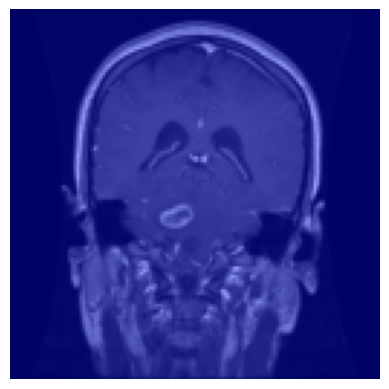

In [ ]:
plt.imshow(visualization)
plt.axis('off')
plt.show()

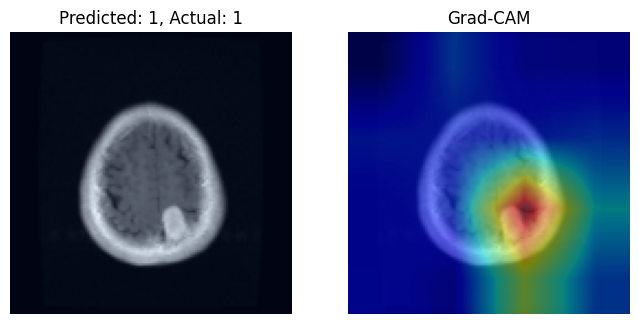

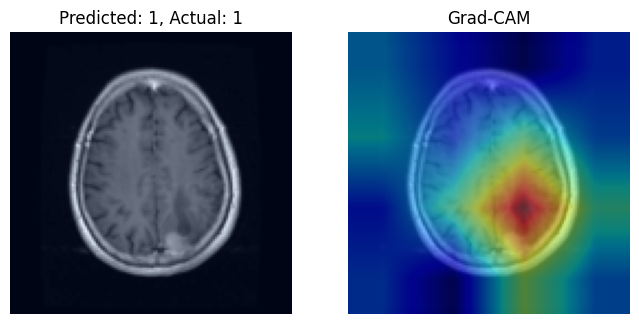

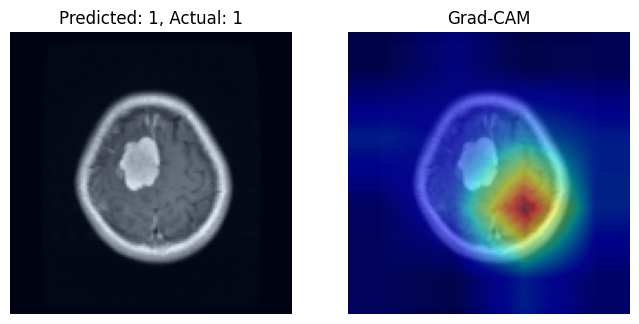

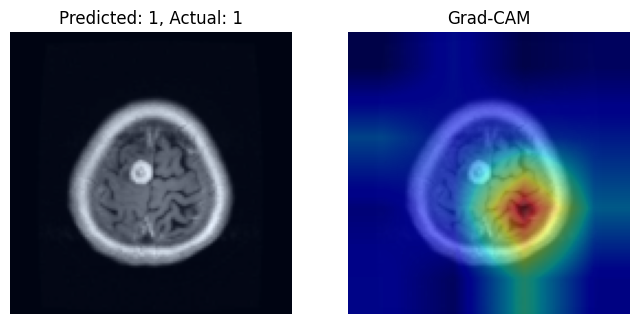

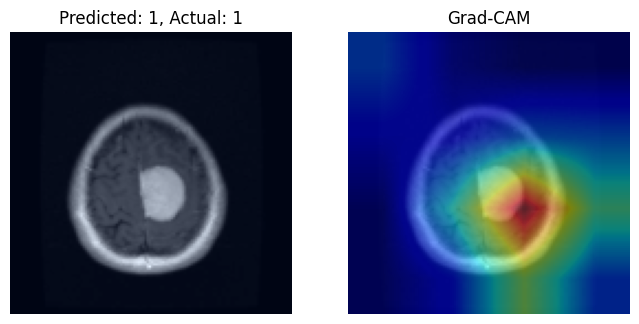

...

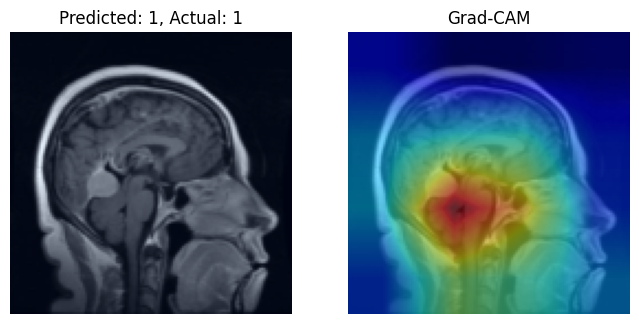

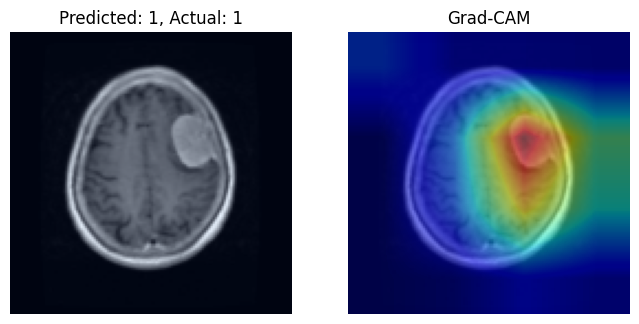

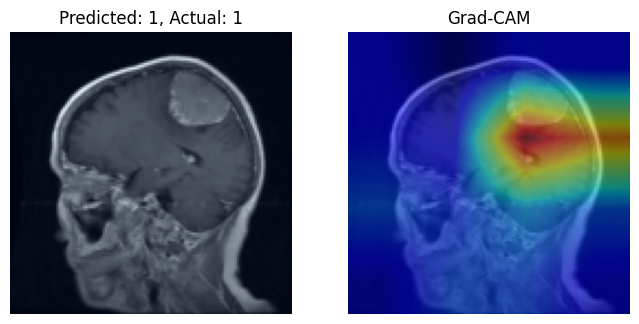

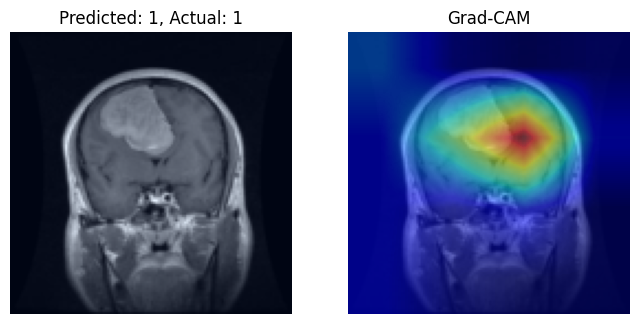

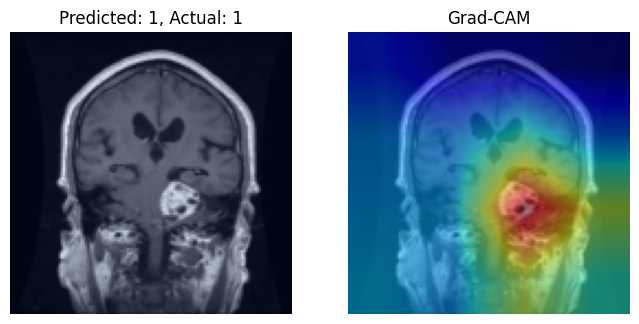

In [ ]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image

def visualize_neurons_responsible_for_class(model, samples, specific_category_idx):

    gradcam = GradCAM(model=model, target_layers=[model.base_model.features[-1]])

    for idx, (image, pred, label) in enumerate(samples):
        if label.item() == specific_category_idx:

            input_tensor = image.unsqueeze(0).to(device)
            targets = [ClassifierOutputTarget(pred.item())]


            grayscale_cam = gradcam(input_tensor=input_tensor, targets=targets)
            grayscale_cam = grayscale_cam[0, :]


            image_np = np.transpose(image.cpu().numpy(), (1, 2, 0))
            image_np = (image_np - image_np.min()) / (image_np.max() - image_np.min())


            plt.figure(figsize=(8, 8))
            plt.subplot(1, 2, 1)
            plt.imshow(image_np)
            plt.title(f'Predicted: {pred.item()}, Actual: {label.item()}')
            plt.axis('off')

            plt.subplot(1, 2, 2)
            plt.imshow(image_np)
            plt.imshow(grayscale_cam, cmap='jet', alpha=0.5)
            plt.title('Grad-CAM')
            plt.axis('off')
            plt.show()
        if idx == 50:
            break




specific_category_idx = 1
visualize_neurons_responsible_for_class(model, correct_samples, specific_category_idx)


# Trying out Efficient Net

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
from torchvision import models
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
from torch.optim import Adamax

# Define the device to be used
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")





class_count = 4

# Load the EfficientNetB3 model pretrained on ImageNet
base_model = models.efficientnet_b3(weights='IMAGENET1K_V1')
base_model.classifier = nn.Identity()  # Remove the classifier

# Create the model
class CustomModel(nn.Module):
    def __init__(self, base_model, class_count):
        super(CustomModel, self).__init__()
        self.base_model = base_model
        self.batch_norm = nn.BatchNorm1d(1536, momentum=0.99, eps=0.001)
        self.fc1 = nn.Linear(1536, 256)
        self.relu = nn.ReLU()
        self.dropout = nn.Dropout(p=0.45)
        self.fc2 = nn.Linear(256, class_count)
        self.softmax = nn.Softmax(dim=1)

    def forward(self, x):
        x = self.base_model(x)
        x = self.batch_norm(x)
        x = self.fc1(x)
        x = self.relu(x)
        x = self.dropout(x)
        x = self.fc2(x)
        x = self.softmax(x)
        return x

model1 = CustomModel(base_model, class_count).to(device)

# Define optimizer and loss function
optimizer = Adamax(model1.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss()



In [ ]:
# Training the model
epochs = 6
for epoch in range(epochs):
    model1.train()
    running_loss = 0.0
    for images, labels in train_loader:
        images, labels = images.to(device), labels.to(device)

        optimizer.zero_grad()

        outputs = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    print(f"Epoch [{epoch+1}/{epochs}], Loss: {running_loss/len(train_loader):.4f}")

    # Validation phase
    model.eval()
    val_loss = 0.0
    correct = 0
    total = 0
    with torch.no_grad():
        for images, labels in val_loader:
            images, labels = images.to(device), labels.to(device)

            outputs = model1(images)
            loss = criterion(outputs, labels)

            val_loss += loss.item()

            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

    print(f"Validation Loss: {val_loss/len(val_loader):.4f}, Accuracy: {100 * correct / total:.2f}%")


Epoch [1/6], Loss: 0.9153
Validation Loss: 0.8181, Accuracy: 92.30%
Epoch [2/6], Loss: 0.8330
Validation Loss: 0.7980, Accuracy: 94.40%
Epoch [3/6], Loss: 0.8248
Validation Loss: 0.7907, Accuracy: 95.36%
Epoch [4/6], Loss: 0.8032
Validation Loss: 0.7873, Accuracy: 95.36%
Epoch [5/6], Loss: 0.8001
Validation Loss: 0.7859, Accuracy: 95.63%
Epoch [6/6], Loss: 0.7912
Validation Loss: 0.7953, Accuracy: 94.75%


In [ ]:
all_labels = []
all_predictions = []

with torch.no_grad():
    for images, labels in test_loader:
        images, labels = images.to(device), labels.to(device)
        outputs = model1(images)
        _, predicted = torch.max(outputs.data, 1)
        all_labels.extend(labels.cpu().numpy())
        all_predictions.extend(predicted.cpu().numpy())

# Print accuracy
correct = sum(p == t for p, t in zip(all_predictions, all_labels))
total = len(all_labels)
print(f'Accuracy of the model on the Test images: {100 * correct / total}%')

# Generate classification report
report = classification_report(all_labels, all_predictions, target_names=['glioma', 'meningioma', 'notumor', 'pituitary'])
print("Classification Report:\n", report)

Accuracy of the model on the Test images: 97.25400457665904%
Classification Report:
               precision    recall  f1-score   support

      glioma       0.97      0.98      0.97       300
  meningioma       0.93      0.96      0.95       306
     notumor       0.99      0.99      0.99       405
   pituitary       0.99      0.96      0.98       300

    accuracy                           0.97      1311
   macro avg       0.97      0.97      0.97      1311
weighted avg       0.97      0.97      0.97      1311



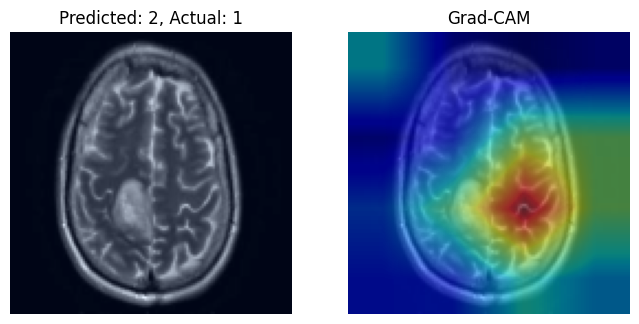

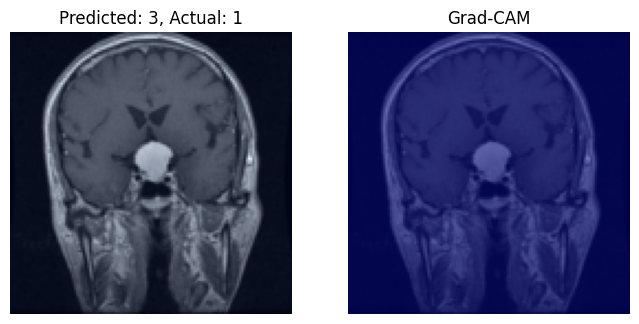

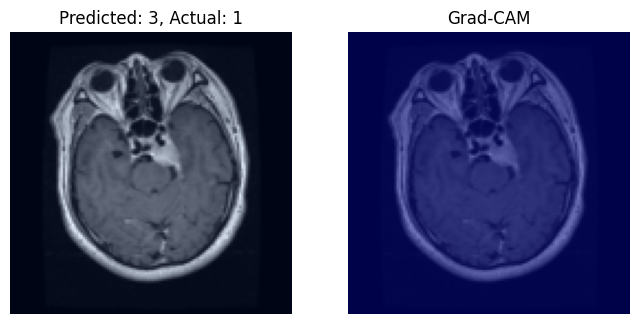

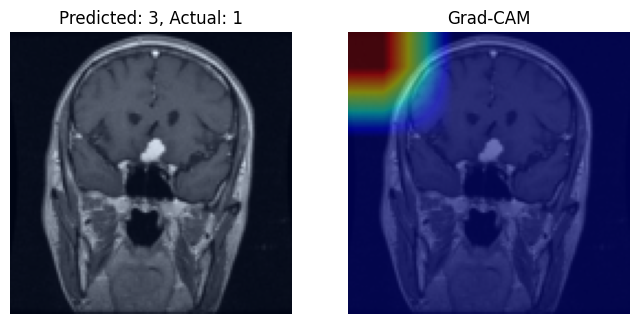

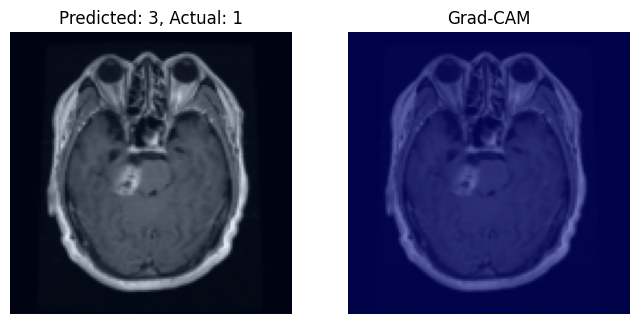

...

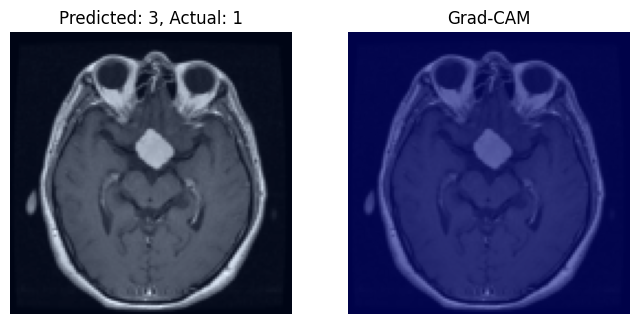

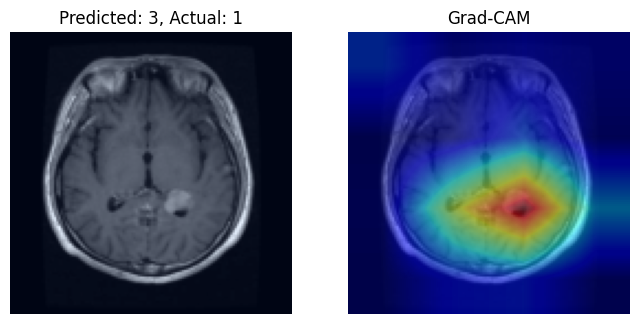

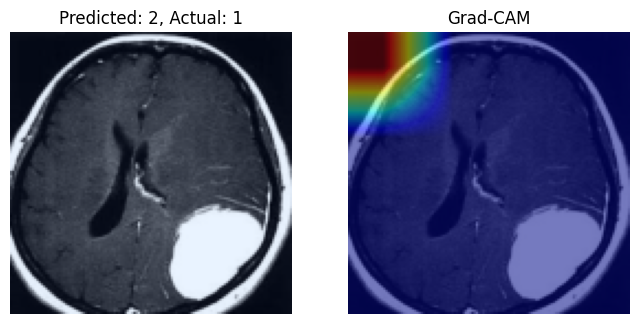

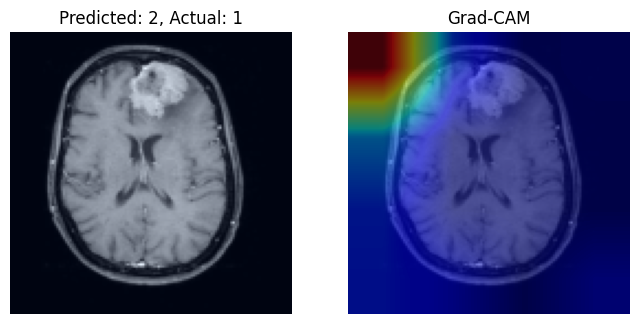

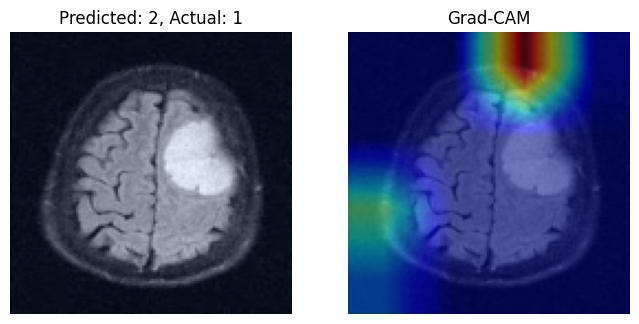

In [ ]:
specific_category_idx = 1
visualize_neurons_responsible_for_class(model1, wrong_samples, specific_category_idx)